<a href="https://colab.research.google.com/github/markcam1/machine-learning-00/blob/main/Final_Project_Tech27_Part-2_Clustering-01.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Clustering and Predictive Modeling of S&P 500 Stock Price Behaviors

**Clustering Part 1**

# Imports

In [ ]:
# Imports

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score, davies_bouldin_score
import hdbscan
import umap.umap_ as umap
import warnings
warnings.filterwarnings('ignore')

# Set plotting style
plt.style.use('default')
sns.set_palette("husl")

print("Unsupervised Learning")
print("=" * 60)
print(f"Analysis Date: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}")


Unsupervised Learning
Analysis Date: 2025-08-28 13:57:29


# Data Load




## File Upload

In [ ]:
# Step 1: Mount your Google Drive again
from google.colab import drive
drive.mount('/content/drive')

# Step 2: Import pandas and load the file using its path
import pandas as pd
df = pd.read_csv('/content/drive/MyDrive/sp500_stocks_feature-eng.csv')

# (Optional but recommended) Check the first few rows to make sure it loaded correctly
print("File loaded successfully!")
print(df.head())


Mounted at /content/drive
File loaded successfully!
         Date Symbol       Open       High        Low      Close     Volume  \
0  2010-02-17      A  19.333031  19.575014  19.186569  19.504965  4891183.0   
1  2010-02-18      A  19.466763  19.740585  19.383981  19.727848  3313959.0   
2  2010-02-19      A  19.638699  19.912520  19.498604  19.867945  4186171.0   
3  2010-02-22      A  19.925251  19.925251  19.645064  19.836102  4038123.0   
4  2010-02-23      A  19.797895  19.842470  19.441291  19.645065  4366373.0   

   Year    Return  Annual_Vol  ...  Volume_MA_30  Volume_Ratio_10d  PV_Trend  \
0  2010  0.008893     0.23301  ...  5.170074e+06          0.724769  0.136982   
1  2010  0.013412     0.23301  ...  5.141005e+06          0.512090  0.201361   
2  2010  0.011673     0.23301  ...  5.172418e+06          0.672281  0.177984   
3  2010 -0.004474     0.23301  ...  5.203850e+06          0.711443 -0.068058   
4  2010 -0.007719     0.23301  ...  5.224932e+06          0.805576 -0.118

## Dataset review

In [ ]:
####################################
# BASIC DATASET INFO

print(f"\nDATASET OVERVIEW:")
print("-" * 30)
print(f"Shape: {df.shape[0]:,} rows × {df.shape[1]} columns")
print(f"Memory Usage: {df.memory_usage(deep=True).sum() / 1024 / 1024:.2f} MB")
print(f"Date Range: {df['Date'].min()} to {df['Date'].max()}")


DATASET OVERVIEW:
------------------------------
Shape: 1,660,958 rows × 47 columns
Memory Usage: 1029.33 MB
Date Range: 2010-02-17 to 2025-08-15


In [ ]:
######################
# COLUMN ANALYSIS

print(f"\nCOLUMN DETAILS:")
print("-" * 30)

# Column info table
column_info = pd.DataFrame({
    'Column': df.columns,
    'Data Type': df.dtypes,
    'Non-Null Count': df.count(),
    'Null Count': df.isnull().sum(),
    'Null %': (df.isnull().sum() / len(df) * 100).round(2),
    'Unique Values': [df[col].nunique() for col in df.columns],
    'Memory Usage (KB)': (df.memory_usage(deep=True, index=False) / 1024).round(2),
    'Memory Usage (GB)': (df.memory_usage(deep=True, index=False) / (1024 ** 3)).round(4)
})

print(column_info.to_string(index=False))


COLUMN DETAILS:
------------------------------
                   Column Data Type  Non-Null Count  Null Count  Null %  Unique Values  Memory Usage (KB)  Memory Usage (GB)
                     Date    object         1660958           0     0.0           3899           95699.73             0.0913
                   Symbol    object         1660958           0     0.0            426           84524.48             0.0806
                     Open   float64         1660958           0     0.0        1496255           12976.23             0.0124
                     High   float64         1660958           0     0.0        1496968           12976.23             0.0124
                      Low   float64         1660958           0     0.0        1496281           12976.23             0.0124
                    Close   float64         1660958           0     0.0        1395584           12976.23             0.0124
                   Volume   float64         1660958           0     0.0      

In [ ]:
#####################################
# DATA TYPES AND SAMPLE DATA

print(f"\nDATA TYPES:")
print("-" * 30)
print(df.dtypes)

print(f"\nFIRST 5 ROWS:")
print("-" * 30)
print(df.head())

print(f"\nLAST 5 ROWS:")
print("-" * 30)
print(df.tail())

print(f"\nRANDOM SAMPLE (5 rows):")
print("-" * 30)
print(df.sample(5))


DATA TYPES:
------------------------------
Date                          object
Symbol                        object
Open                         float64
High                         float64
Low                          float64
Close                        float64
Volume                       float64
Year                           int64
Return                       float64
Annual_Vol                   float64
Roll_Vol_30d                 float64
Return_Daily                 float64
Return_t-1                   float64
Return_t-2                   float64
MA_5                         float64
MA_10                        float64
MA_20                        float64
MA_50                        float64
MA_200                       float64
Price_to_MA20                float64
Price_to_MA50                float64
EMA_5                        float64
EMA_10                       float64
EMA_12                       float64
EMA_20                       float64
EMA_26                       fl

In [ ]:
#############################
# DATA QUALITY CHECK

print(f"\nDATA QUALITY ASSESSMENT:")
print("-" * 30)

quality_issues = []

# Check for missing values
missing_data = df.isnull().sum()
if missing_data.any():
    print("Missing Data Found:")
    for col, missing in missing_data[missing_data > 0].items():
        pct_missing = (missing / len(df)) * 100
        print(f"   {col}: {missing:,} rows ({pct_missing:.2f}%)")
        quality_issues.append(f"Missing data in {col}")
else:
    print("No missing values found")

# Check for duplicates
duplicates = df.duplicated().sum()
if duplicates > 0:
    print(f"Duplicate rows: {duplicates:,}")
    quality_issues.append("Duplicate rows found")
else:
    print("No duplicate rows found")

# Check for negative values in price columns
price_cols = ['Open', 'High', 'Low', 'Close']
for col in price_cols:
    if col in df.columns:
        negative_prices = (df[col] < 0).sum()
        if negative_prices > 0:
            print(f"Negative values in {col}: {negative_prices}")
            quality_issues.append(f"Negative values in {col}")

# Check for High < Low (impossible scenario)
if 'High' in df.columns and 'Low' in df.columns:
    impossible_prices = (df['High'] < df['Low']).sum()
    if impossible_prices > 0:
        print(f"High < Low anomalies: {impossible_prices}")
        quality_issues.append("High price less than Low price")

# Volume check
if 'Volume' in df.columns:
    zero_volume = (df['Volume'] == 0).sum()
    if zero_volume > 0:
        print(f"Zero volume days: {zero_volume:,} ({zero_volume/len(df)*100:.2f}%)")

print(f"\nQUALITY SUMMARY:")
if quality_issues:
    print(f"Issues found: {len(quality_issues)}")
    for issue in quality_issues:
        print(f"   • {issue}")
else:
    print("Data quality looks good!")


DATA QUALITY ASSESSMENT:
------------------------------
No missing values found
No duplicate rows found

QUALITY SUMMARY:
Data quality looks good!


In [ ]:

###################
# Stock stats:


if 'Symbol' in df.columns:
    print(f"\nSTOCK SYMBOLS ANALYSIS:")
    print("-" * 30)

    symbol_stats = pd.DataFrame({
        'Total Unique Stocks': df['Symbol'].nunique(),
        'Most Records (Stock)': df['Symbol'].value_counts().index[0],
        'Max Records per Stock': df['Symbol'].value_counts().iloc[0],
        'Least Records (Stock)': df['Symbol'].value_counts().index[-1],
        'Min Records per Stock': df['Symbol'].value_counts().iloc[-1],
        'Avg Records per Stock': round(df['Symbol'].value_counts().mean(), 1)
    }, index=[0])

    print(symbol_stats.T.to_string(header=False))

    print(f"\nTOP 10 STOCKS BY RECORD COUNT:")
    print(df['Symbol'].value_counts().head(10).to_string())

    print(f"\nBOTTOM 10 STOCKS BY RECORD COUNT:")
    print(df['Symbol'].value_counts().tail(10).to_string())


STOCK SYMBOLS ANALYSIS:
------------------------------
Total Unique Stocks       426
Most Records (Stock)     ZBRA
Max Records per Stock    3899
Least Records (Stock)     PFG
Min Records per Stock    3897
Avg Records per Stock  3899.0

TOP 10 STOCKS BY RECORD COUNT:
Symbol
ZBRA    3899
A       3899
AAPL    3899
ABT     3899
ACGL    3899
ACN     3899
ADBE    3899
ADI     3899
ADM     3899
ADP     3899

BOTTOM 10 STOCKS BY RECORD COUNT:
Symbol
GEN     3898
ERIE    3898
CNC     3898
DXCM    3898
DOC     3898
CHD     3898
BKR     3898
CCI     3898
VRTX    3898
PFG     3897


In [ ]:
########################################
# Stats for columns

print(f"\Column Stats:")
print("-" * 30)

if 'Close' in df.columns:
    print(f"Price Range: ${df['Close'].min():.2f} - ${df['Close'].max():.2f}")
    print(f"Average Price: ${df['Close'].mean():.2f}")
    print(f"Median Price: ${df['Close'].median():.2f}")

if 'Volume' in df.columns:
    print(f"Volume Range: {df['Volume'].min():,} - {df['Volume'].max():,}")
    print(f"Average Volume: {df['Volume'].mean():,.0f}")

if 'Symbol' in df.columns:
    data_completeness = df.groupby('Symbol').size()
    complete_stocks = (data_completeness == data_completeness.max()).sum()
    print(f"Complete data stocks: {complete_stocks} out of {df['Symbol'].nunique()}")

\Column Stats:
------------------------------
Price Range: $0.20 - $9924.40
Average Price: $103.07
Median Price: $54.29
Volume Range: 600.0 - 3,692,928,000.0
Average Volume: 7,044,966
Complete data stocks: 411 out of 426


In [ ]:
############################
# Numerical Columns:

print(f"\nNUMERICAL COLUMNS STATISTICS:")
print("-" * 30)

numerical_cols = df.select_dtypes(include=[np.number]).columns.tolist()
print(f"Numerical columns: {numerical_cols}")
print()
print(df[numerical_cols].describe())



NUMERICAL COLUMNS STATISTICS:
------------------------------
Numerical columns: ['Open', 'High', 'Low', 'Close', 'Volume', 'Year', 'Return', 'Annual_Vol', 'Roll_Vol_30d', 'Return_Daily', 'Return_t-1', 'Return_t-2', 'MA_5', 'MA_10', 'MA_20', 'MA_50', 'MA_200', 'Price_to_MA20', 'Price_to_MA50', 'EMA_5', 'EMA_10', 'EMA_12', 'EMA_20', 'EMA_26', 'EMA_50', 'Price_to_EMA10', 'Price_to_EMA20', 'Price_to_EMA50', 'EMA_Cross_5_10', 'EMA_Cross_10_20', 'MACD', 'MACD_Signal', 'MACD_Histogram', 'RSI', 'Volume_MA_10', 'Volume_MA_30', 'Volume_Ratio_10d', 'PV_Trend', 'Sharpe_252d', 'Target_Return_Next_Day', 'Target_Direction_Next_Day', 'Target_Return_Next_Week']

               Open          High           Low         Close        Volume  \
count  1.660958e+06  1.660958e+06  1.660958e+06  1.660958e+06  1.660958e+06   
mean   1.030498e+02  1.041873e+02  1.018926e+02  1.030675e+02  7.044966e+06   
std    2.465424e+02  2.494684e+02  2.436931e+02  2.466088e+02  3.346570e+07   
min    1.998924e-01  2.074570

In [ ]:
################################
# Categorial Columns review

print(f"\nCATEGORICAL COLUMNS ANALYSIS:")
print("-" * 30)

categorical_cols = df.select_dtypes(include=['object', 'category']).columns.tolist()
if 'Date' in categorical_cols:
    categorical_cols.remove('Date')  # Date is now datetime

for col in categorical_cols:
    print(f"\n  {col}:")
    print(f"   Unique values: {df[col].nunique()}")
    print(f"   Most common values:")
    print(df[col].value_counts().head().to_string())
    if df[col].nunique() <= 20:  # Show all if not too many
        print(f"   All unique values: {sorted(df[col].unique().tolist())}")



CATEGORICAL COLUMNS ANALYSIS:
------------------------------

  Symbol:
   Unique values: 426
   Most common values:
Symbol
ZBRA    3899
A       3899
AAPL    3899
ABT     3899
ACGL    3899

  Sector:
   Unique values: 11
   Most common values:
Sector
Technology            237837
Financial Services    237835
Industrials           233939
Healthcare            214442
Consumer Cyclical     179354
   All unique values: ['Basic Materials', 'Communication Services', 'Consumer Cyclical', 'Consumer Defensive', 'Energy', 'Financial Services', 'Healthcare', 'Industrials', 'Real Estate', 'Technology', 'Utilities']

  Industry:
   Unique values: 109
   Most common values:
Industry
Utilities - Regulated Electric    89676
Specialty Industrial Machinery    46788
Semiconductors                    46787
Diagnostics & Research            38990
Software - Application            38990

  Longname:
   Unique values: 425
   Most common values:
Longname
Alphabet Inc.                     7798
Nordson Corporat

# Clustering

In [ ]:
####################
# Import libraries
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score, davies_bouldin_score
import hdbscan
import umap.umap_ as umap
import warnings
warnings.filterwarnings('ignore')

# Set plotting style
plt.style.use('default')
sns.set_palette("husl")

## Feature columns and Standardization

In [ ]:
# Select numerical features for clustering (excluding target variables and identifiers)
feature_columns = [
    'Return', 'Annual_Vol', 'Roll_Vol_30d', 'Return_Daily',
    'Return_t-1', 'Return_t-2', 'Price_to_MA20', 'Price_to_MA50',
    'Price_to_EMA10', 'Price_to_EMA20', 'Price_to_EMA50',
    'EMA_Cross_5_10', 'EMA_Cross_10_20', 'MACD', 'MACD_Signal',
    'MACD_Histogram', 'RSI', 'Volume_Ratio_10d', 'PV_Trend', 'Sharpe_252d'
]

# Create feature matrix
X = df[feature_columns].copy()

print("Feature matrix shape:", X.shape)
print("Features selected:", feature_columns)

Feature matrix shape: (1660958, 20)
Features selected: ['Return', 'Annual_Vol', 'Roll_Vol_30d', 'Return_Daily', 'Return_t-1', 'Return_t-2', 'Price_to_MA20', 'Price_to_MA50', 'Price_to_EMA10', 'Price_to_EMA20', 'Price_to_EMA50', 'EMA_Cross_5_10', 'EMA_Cross_10_20', 'MACD', 'MACD_Signal', 'MACD_Histogram', 'RSI', 'Volume_Ratio_10d', 'PV_Trend', 'Sharpe_252d']


## PCA

In [ ]:
################################
# Standardize features
print("Scaling features ...")
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
print("Features scaled successfully!")
print("\nScaled data shape:", X_scaled.shape)
print("Mean of scaled features:", np.mean(X_scaled, axis=0)[:5])  # Should be close to 0
print("Std of scaled features:", np.std(X_scaled, axis=0)[:5])   # Should be close to 1

# Create PCA for visualization
pca = PCA(n_components=2, random_state=42)
X_pca = pca.fit_transform(X_scaled)

print(f"\nPCA explained variance ratio: {pca.explained_variance_ratio_}")
print(f"Total variance explained: {pca.explained_variance_ratio_.sum():.3f}")

Scaling features ...
Features scaled successfully!

Scaled data shape: (1660958, 20)
Mean of scaled features: [ 4.22871315e-18 -1.39986875e-15 -8.48600274e-16 -2.34429419e-18
  1.53469989e-17]
Std of scaled features: [1. 1. 1. 1. 1.]

PCA explained variance ratio: [0.3381802  0.16069858]
Total variance explained: 0.499


In [ ]:
# adjusting pca for explained variance
pca_05 = PCA(n_components=5, random_state=42)
X_pca_05 = pca_05.fit_transform(X_scaled)

print(f"\nPCA explained variance ratio: {pca_05.explained_variance_ratio_}")
print(f"Total variance explained: {pca_05.explained_variance_ratio_.sum():.3f}")


PCA explained variance ratio: [0.3381802  0.16069858 0.10569272 0.08044361 0.06363258]
Total variance explained: 0.749


## K-Means

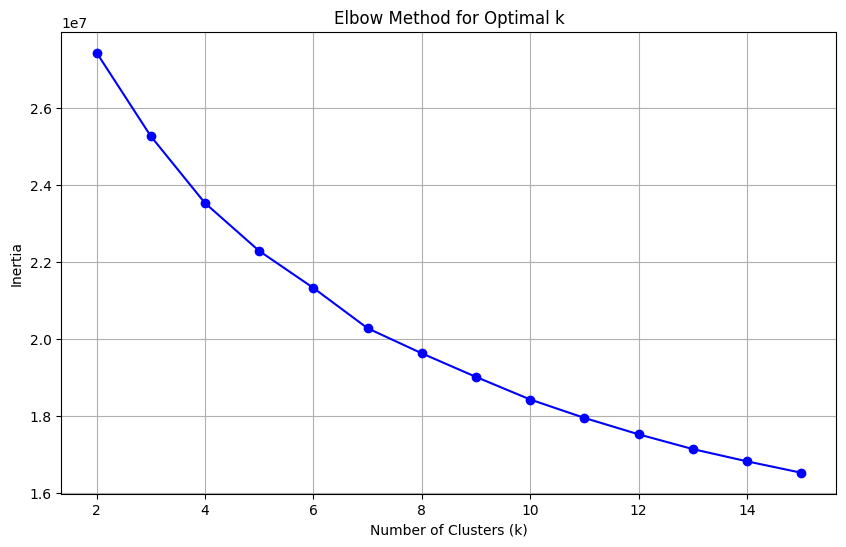

In [ ]:
# Determine optimal number of clusters using elbow method
def plot_elbow_method(X, max_k=15):
    inertias = []
    k_range = range(2, max_k + 1)

    for k in k_range:
        kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
        kmeans.fit(X)
        inertias.append(kmeans.inertia_)

    plt.figure(figsize=(10, 6))
    plt.plot(k_range, inertias, 'bo-')
    plt.xlabel('Number of Clusters (k)')
    plt.ylabel('Inertia')
    plt.title('Elbow Method for Optimal k')
    plt.grid(True)
    plt.show()

# Plot elbow method
plot_elbow_method(X_scaled)

In [ ]:
# Based on elbow method, select fewer k values to test
'''
* Silhouette Score for k=5 was 0.120, while k=3 was 0.159
* Davies-Bouldin Score for k=5 was 1.769, while k=7 was 1.618.
'''

k_values = [3, 4, 5, 6]
kmeans_results = {}

print(f"Testing K-Means on full dataset ({len(X_scaled):,} rows)...")

for i, k in enumerate(k_values):
    print(f"Running K-Means with k={k} ({i+1}/{len(k_values)})...")

    # Fit K-Means
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=3, max_iter=100)
    labels = kmeans.fit_predict(X_scaled)

    print(f"  Clustering completed. Computing metrics...")

    # Calculate metrics on a sample for speed
    # Use 100K sample for metric calculation
    sample_size = min(100000, len(X_scaled))
    sample_idx = np.random.choice(len(X_scaled), size=sample_size, replace=False)

    sil_score = silhouette_score(X_scaled[sample_idx], labels[sample_idx])
    db_score = davies_bouldin_score(X_scaled[sample_idx], labels[sample_idx])

    # Store results
    kmeans_results[k] = {
        'labels': labels,
        'silhouette': sil_score,
        'davies_bouldin': db_score,
        'cluster_sizes': np.bincount(labels)
    }

    print(f"    K-Means with k={k} completed:")
    print(f"    Silhouette Score: {sil_score:.3f}")
    print(f"    Davies-Bouldin Score: {db_score:.3f}")
    print(f"    Cluster sizes: {np.bincount(labels)}")

Testing K-Means on full dataset (1,660,958 rows)...
Running K-Means with k=3 (1/4)...
  Clustering completed. Computing metrics...
    K-Means with k=3 completed:
    Silhouette Score: 0.162
    Davies-Bouldin Score: 1.918
    Cluster sizes: [916411 470995 273552]
Running K-Means with k=4 (2/4)...
  Clustering completed. Computing metrics...
    K-Means with k=4 completed:
    Silhouette Score: 0.122
    Davies-Bouldin Score: 2.023
    Cluster sizes: [589619 197782 741599 131958]
Running K-Means with k=5 (3/4)...
  Clustering completed. Computing metrics...
    K-Means with k=5 completed:
    Silhouette Score: 0.119
    Davies-Bouldin Score: 1.766
    Cluster sizes: [578122 135691 226532   2182 718431]
Running K-Means with k=6 (4/4)...
  Clustering completed. Computing metrics...
    K-Means with k=6 completed:
    Silhouette Score: 0.126
    Davies-Bouldin Score: 1.770
    Cluster sizes: [687292   2100  91329 220743 207956 451538]


### K-means analysis

Analysis of the Final Metrics
Silhouette Score: The score for k=3 (0.162) is the clear winner, being significantly higher than all other k values. A higher Silhouette Score indicates that the clusters are more distinct and well-separated from one another, which is a key goal of most clustering tasks.

Davies-Bouldin Score: The scores for k=5 and k=6 are the lowest, which suggests a high degree of internal compactness. However, the score for k=4 is surprisingly the worst of the group, which shows that the algorithm struggled to find a good partitioning with four clusters. The low scores for k=5 and k=6 are likely influenced by the presence of a few very small, tightly packed clusters that may not be meaningful.

Cluster Sizes:

k=3 and k=4 result in a good distribution of cluster sizes.

k=5 and k=6 both produce a very small cluster (2182 and 2100 data points, respectively). These are likely outliers or noise, and segmenting them into their own cluster may not provide valuable insights for your overall analysis of S&P 500 stocks.

Conclusion
Based on a comprehensive review of all the evidence—the Elbow Method, the Silhouette Score, the Davies-Bouldin Score, and the resulting cluster sizes—the most robust and justifiable choice for your S&P 500 stock clustering is k=3.

The Silhouette Score is a very strong indicator of well-defined clusters, and k=3 outperforms all other options by a substantial margin. Furthermore, the balanced cluster sizes for k=3 suggest that the clustering algorithm has identified three fundamental, high-level divisions within the dataset.

In [ ]:
# save your results
import pickle

# Save all results to files
with open('kmeans_results.pkl', 'wb') as f:
    pickle.dump(kmeans_results, f)

# Also save the scaled data and other key objects
np.save('X_scaled.npy', X_scaled)
np.save('X_pca.npy', X_pca)

# Save a summary for quick reference
summary_data = {
    'dataset_shape': df.shape,
    'features_used': feature_columns,
    'kmeans_summary': {k: {'silhouette': v['silhouette'],
                           'davies_bouldin': v['davies_bouldin'],
                           'cluster_sizes': v['cluster_sizes'].tolist()}
                      for k, v in kmeans_results.items()}
}

with open('analysis_summary.pkl', 'wb') as f:
    pickle.dump(summary_data, f)

print("  Results saved! Files created:")
print("- kmeans_results.pkl")
print("- X_scaled.npy")
print("- X_pca.npy")
print("- analysis_summary.pkl")

✅ Results saved! Files created:
- kmeans_results.pkl
- X_scaled.npy
- X_pca.npy
- analysis_summary.pkl


## Load Pickle X, K-Means results

In [ ]:
# Load your results back
import pickle
import numpy as np

# Load results
with open('kmeans_results.pkl', 'rb') as f:
    kmeans_results = pickle.load(f)

# Load data
X_scaled = np.load('X_scaled.npy')
X_pca = np.load('X_pca.npy')

# # Load summary
with open('analysis_summary.pkl', 'rb') as f:
    summary_data = pickle.load(f)

print("Data loaded successfully!")

ValueError: cannot reshape array of size 18743280 into shape (20,1660958)

In [ ]:
!df -h

Filesystem      Size  Used Avail Use% Mounted on
overlay         108G   40G   69G  37% /
tmpfs            64M     0   64M   0% /dev
shm             5.8G     0  5.8G   0% /dev/shm
/dev/root       2.0G  1.2G  775M  61% /usr/sbin/docker-init
tmpfs           6.4G  352K  6.4G   1% /var/colab
/dev/sda1        73G   41G   33G  56% /kaggle/input
tmpfs           6.4G     0  6.4G   0% /proc/acpi
tmpfs           6.4G     0  6.4G   0% /proc/scsi
tmpfs           6.4G     0  6.4G   0% /sys/firmware
drive            15G   14G  1.4G  92% /content/drive


In [ ]:
import pickle

with open("kmeans_results.pkl", "rb") as f:
    try:
        kmeans_results = pickle.load(f)
    except EOFError:
        print("File seems cut off (EOFError).")
    except pickle.UnpicklingError as e:
        print("UnpicklingError:", e)


In [ ]:
import pickletools

with open("kmeans_results.pkl", "rb") as f:
    pickletools.dis(f)


    0: \x80 PROTO      4
    2: \x95 FRAME      150
   11: }    EMPTY_DICT
   12: \x94 MEMOIZE    (as 0)
   13: (    MARK
   14: K        BININT1    3
   16: }        EMPTY_DICT
   17: \x94     MEMOIZE    (as 1)
   18: (        MARK
   19: \x8c         SHORT_BINUNICODE 'labels'
   27: \x94         MEMOIZE    (as 2)
   28: \x8c         SHORT_BINUNICODE 'numpy._core.multiarray'
   52: \x94         MEMOIZE    (as 3)
   53: \x8c         SHORT_BINUNICODE '_reconstruct'
   67: \x94         MEMOIZE    (as 4)
   68: \x93         STACK_GLOBAL
   69: \x94         MEMOIZE    (as 5)
   70: \x8c         SHORT_BINUNICODE 'numpy'
   77: \x94         MEMOIZE    (as 6)
   78: \x8c         SHORT_BINUNICODE 'ndarray'
   87: \x94         MEMOIZE    (as 7)
   88: \x93         STACK_GLOBAL
   89: \x94         MEMOIZE    (as 8)
   90: K            BININT1    0
   92: \x85         TUPLE1
   93: \x94         MEMOIZE    (as 9)
   94: C            SHORT_BINBYTES b'b'
   97: \x94         MEMOIZE    (as 10)
   98:

## Agglomerative Clustering


In [ ]:
print(f"Shape of the scaled data (X_scaled): {X_scaled.shape}")
print(f"Shape of the PCA-transformed data (X_pca): {X_pca.shape}")
print("-" * 50)

NameError: name 'X_scaled' is not defined

Generating a Dendrogram from a sample of the data ... 
Dendrogram plot created


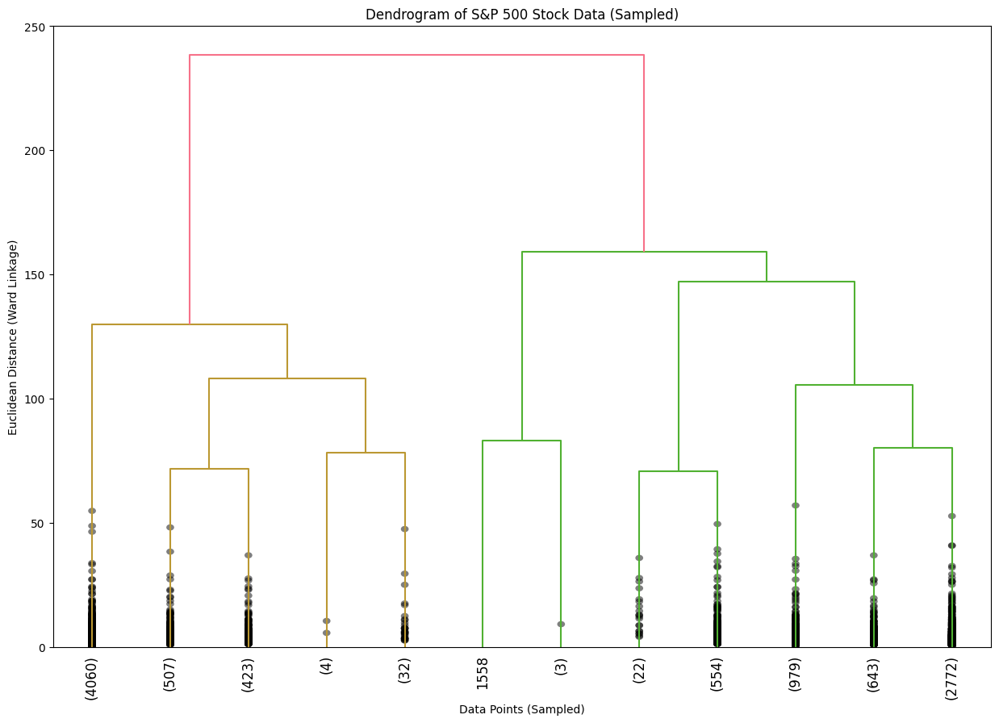

--------------------------------------------------


In [ ]:
import scipy.cluster.hierarchy as shc

# A dendrogram is a tree-like diagram that records the sequences of merges
# or splits. We can use it to help decide on the optimal number of clusters.
# NOTE: We will use a random sample of the data.
print("Generating a Dendrogram from a sample of the data ... ")

# Take a random sample of 10,000 data points
sample_size = min(10000, X_scaled.shape[0])
np.random.seed(42)
sample_indices = np.random.choice(X_scaled.shape[0], sample_size, replace=False)
X_sample = X_scaled[sample_indices]

plt.figure(figsize=(15, 10))
plt.title("Dendrogram of S&P 500 Stock Data (Sampled)")
plt.xlabel("Data Points (Sampled)")
plt.ylabel("Euclidean Distance (Ward Linkage)")

# The 'linkage' function calculates the distance between clusters.
linkage_matrix = shc.linkage(X_sample, method='ward')

# The 'dendrogram' function plots the hierarchy.
shc.dendrogram(linkage_matrix,
               truncate_mode='lastp',  # Show only the last p merged clusters
               p=12,  # The number of merge clusters to show
               leaf_rotation=90.,
               leaf_font_size=12.,
               show_contracted=True) # To get a tidy plot

print("Dendrogram plot created")
plt.show()
print("-" * 50)

In [ ]:
# # Agglomerative Clustering
# # 5 clusters as a starting point.
# print("Performing Agglomerative Clustering ... ")
# # We will use the full dataset for the actual clustering
# num_clusters = 5
# print(f"Initializing Agglomerative Clustering with {num_clusters} clusters.")

# # Initialize the model
# agg_cluster_model = AgglomerativeClustering(n_clusters=num_clusters, metric='euclidean', linkage='ward')

# # Fit the model and get the cluster labels for each data point
# print("Fitting the model to the scaled data...")
# agg_labels = agg_cluster_model.fit_predict(X_scaled)
# print("Clustering complete.")
# print(f"Unique cluster labels found: {np.unique(agg_labels)}")
# print("-" * 50)

Performing Agglomerative Clustering ... 
Initializing Agglomerative Clustering with 5 clusters.
Fitting the model to the scaled data...


In [ ]:
# we will perform the clustering on a larger sample of the data, not the full dataset.
print("Performing Agglomerative Clustering on a Sample ... ")

# Define a sample size for clustering that is manageable for memory
sample_size_cluster = min(10000, X_scaled.shape[0])
print(f"Taking a random sample of {sample_size_cluster} data points for clustering.")
np.random.seed(42)
sample_indices_cluster = np.random.choice(X_scaled.shape[0], sample_size_cluster, replace=False)

# Create samples from both the scaled data (for clustering) and PCA data (for plotting)
X_scaled_sample = X_scaled[sample_indices_cluster]
X_pca_sample = X_pca[sample_indices_cluster]

num_clusters = 5
print(f"Initializing Agglomerative Clustering with {num_clusters} clusters.")

# Initialize the model
agg_cluster_model = AgglomerativeClustering(n_clusters=num_clusters, metric='euclidean', linkage='ward')

# Fit the model and get the cluster labels for each data point in the sample
print("Fitting the model to the sampled scaled data...")
agg_labels_sample = agg_cluster_model.fit_predict(X_scaled_sample)
print("Clustering complete.")
print(f"Unique cluster labels found: {np.unique(agg_labels_sample)}")
print("-" * 50)


Performing Agglomerative Clustering on a Sample ... 
Taking a random sample of 10000 data points for clustering.
Initializing Agglomerative Clustering with 5 clusters.
Fitting the model to the sampled scaled data...
Clustering complete.
Unique cluster labels found: [0 1 2 3 4]
--------------------------------------------------


Visualizing the clusters on a PCA plot ... 
PCA plot with cluster colors has been generated.


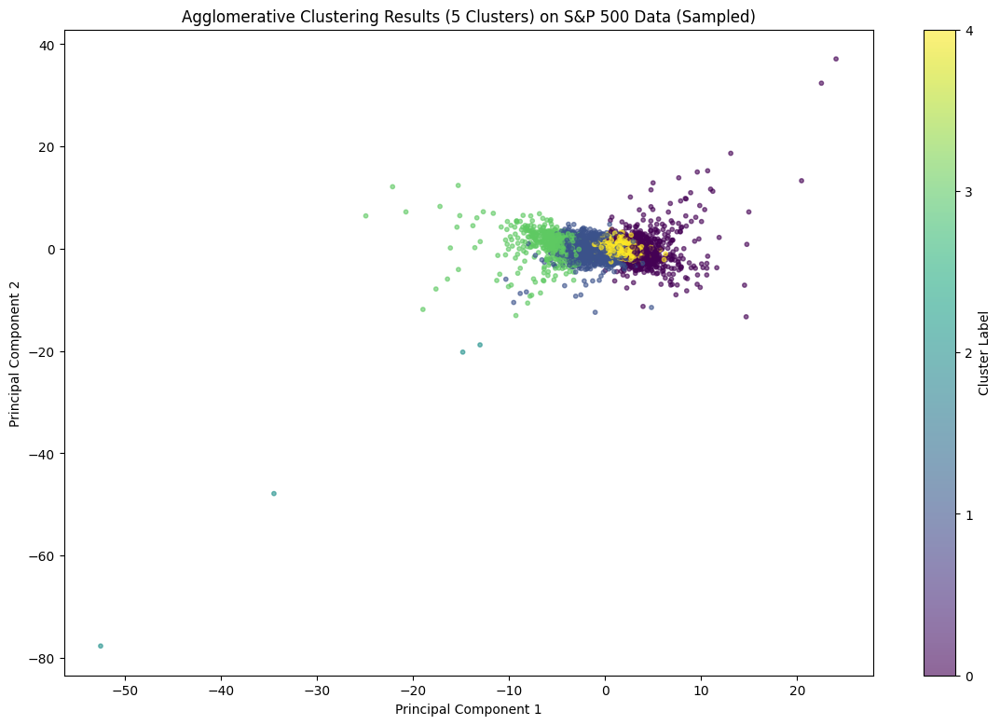

--------------------------------------------------


In [ ]:
# visualize the clusters found by the algorithm on the 2D PCA plot.
print("Visualizing the clusters on a PCA plot ... ")
plt.figure(figsize=(14, 9))

# Create a scatter plot of the first two principal components from our sample
# Color each point according to the cluster label found by Agglomerative Clustering
scatter = plt.scatter(X_pca_sample[:, 0], X_pca_sample[:, 1], c=agg_labels_sample, cmap='viridis', alpha=0.6, s=10)

plt.title(f'Agglomerative Clustering Results ({num_clusters} Clusters) on S&P 500 Data (Sampled)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')

# Add a colorbar to show which color corresponds to which cluster
plt.colorbar(scatter, ticks=range(num_clusters), label='Cluster Label')

print("PCA plot with cluster colors has been generated.")
plt.show()
print("-" * 50)

In [ ]:
# import pandas as pd
# import numpy as np
# from sklearn.cluster import AgglomerativeClustering
# from sklearn.metrics import silhouette_score
# import matplotlib.pyplot as plt
# import seaborn as sns

# # Load clustering dataset
# df_clustering = X_scaled

# # Extract PCA features (5 components)
# pca_columns = [f'PCA_{i+1}' for i in range(5)]
# X_pca = df_clustering[pca_columns]

# # Run Agglomerative Clustering for 5-10 clusters
# silhouette_scores = []
# cluster_range = range(5, 11)
# for n_clusters in cluster_range:
#     agglo = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward')
#     labels = agglo.fit_predict(X_pca)
#     score = silhouette_score(X_pca, labels)
#     silhouette_scores.append(score)
#     print(f"Clusters: {n_clusters}, Silhouette Score: {score:.3f}")

# # Plot silhouette scores
# plt.figure(figsize=(8, 5))
# plt.plot(cluster_range, silhouette_scores, marker='o')
# plt.xlabel('Number of Clusters')
# plt.ylabel('Silhouette Score')
# plt.title('Silhouette Scores for Agglomerative Clustering (Ward Linkage)')
# plt.savefig('/content/drive/MyDrive/S&P500_Project/agglomerative_silhouette_plot.png')
# plt.show()

# # Select optimal number of clusters (highest silhouette score)
# optimal_clusters = cluster_range[np.argmax(silhouette_scores)]
# print(f"Optimal number of clusters: {optimal_clusters}")

# # Run Agglomerative Clustering with optimal clusters
# agglo = AgglomerativeClustering(n_clusters=optimal_clusters, linkage='ward')
# df_clustering['Agglomerative_Cluster'] = agglo.fit_predict(X_pca)

# # Save results
# df_clustering[['Symbol', 'Agglomerative_Cluster', 'Sector', 'Industry', 'Longname', 'UMAP_1', 'UMAP_2']].to_csv(
#     '/content/drive/MyDrive/S&P500_Project/agglomerative_results.csv', index=False
# )
# print("Agglomerative clustering results saved.")

# # Visualize UMAP with cluster labels (for inspection)
# plt.figure(figsize=(10, 6))
# sns.scatterplot(x='UMAP_1', y='UMAP_2', hue='Agglomerative_Cluster', palette='tab10', data=df_clustering)
# plt.title(f'Agglomerative Clustering (k={optimal_clusters}) on UMAP Projection')
# plt.savefig('/content/drive/MyDrive/S&P500_Project/agglomerative_umap_plot.png')
# plt.show()

# # Visualize UMAP with Sector (for alignment check)
# plt.figure(figsize=(10, 6))
# sns.scatterplot(x='UMAP_1', y='UMAP_2', hue='Sector', palette='tab20', data=df_clustering)
# plt.title('UMAP Projection by Sector')
# plt.savefig('/content/drive/MyDrive/S&P500_Project/agglomerative_sector_umap_plot.png')
# plt.show()

In [ ]:
# ########################
# #Agglomerative clustering
# # Ward linkage is most memory-efficient for large datasets.
# agg_results = {}
# n_clusters_list = [3, 5, 7]
# linkage_methods = ['ward']

# print(f"Testing Agglomerative Clustering on full dataset ({len(X_scaled):,} rows)...")

# for n_clusters in n_clusters_list:
#     for linkage in linkage_methods:
#         print(f"Running Agglomerative (n={n_clusters}, linkage={linkage})...")

#         try:
#             # Fit Agglomerative Clustering
#             agg = AgglomerativeClustering(n_clusters=n_clusters, linkage=linkage)
#             labels = agg.fit_predict(X_scaled)

#             print(f"  Clustering completed. Computing metrics...")

#             # Calculate metrics on sample for speed
#             sample_size = min(100000, len(X_scaled))
#             sample_idx = np.random.choice(len(X_scaled), size=sample_size, replace=False)

#             sil_score = silhouette_score(X_scaled[sample_idx], labels[sample_idx])
#             db_score = davies_bouldin_score(X_scaled[sample_idx], labels[sample_idx])

#             # Store results
#             key = f"{n_clusters}_{linkage}"
#             agg_results[key] = {
#                 'labels': labels,
#                 'silhouette': sil_score,
#                 'davies_bouldin': db_score,
#                 'cluster_sizes': np.bincount(labels)
#             }

#             print(f"    Agglomerative (n={n_clusters}, linkage={linkage}) completed:")
#             print(f"    Silhouette Score: {sil_score:.3f}")
#             print(f"    Davies-Bouldin Score: {db_score:.3f}")
#             print(f"    Cluster sizes: {np.bincount(labels)}\n")

#         except MemoryError:
#             print(f"  Memory error with n={n_clusters}, linkage={linkage}. Skipping...")
#             print(f"  Try reducing dataset size or use different method.")

Testing Agglomerative Clustering on full dataset (1,660,958 rows)...
Running Agglomerative (n=3, linkage=ward)...


In [ ]:
# # Agglomerative memory issues management:
# print("Agglomerative clustering requires too much memory for 1.66M rows.")

# # Create a sample
# sample_size = 50000
# best_kmeans_labels = kmeans_results[3]['labels']

# # Sample proportionally from each K-Means cluster
# sample_indices = []
# for cluster_id in np.unique(best_kmeans_labels):
#     cluster_mask = best_kmeans_labels == cluster_id
#     cluster_indices = np.where(cluster_mask)[0]

#     # Calculate proportional sample size for this cluster
#     cluster_proportion = cluster_mask.sum() / len(best_kmeans_labels)
#     cluster_sample_size = int(sample_size * cluster_proportion)

#     # Random sample from this cluster
#     if len(cluster_indices) >= cluster_sample_size:
#         cluster_sample = np.random.choice(cluster_indices, size=cluster_sample_size, replace=False)
#     else:
#         cluster_sample = cluster_indices

#     sample_indices.extend(cluster_sample)

# sample_indices = np.array(sample_indices)
# X_sample = X_scaled[sample_indices]

# print(f"Created stratified sample: {len(X_sample):,} rows")

# # Now run Agglomerative on the sample
# agg_results = {}
# n_clusters_list = [3, 5, 7]
# linkage_methods = ['ward']

# for n_clusters in n_clusters_list:
#     for linkage in linkage_methods:
#         print(f"Running Agglomerative (n={n_clusters}, linkage={linkage}) on sample...")

#         # Fit Agglomerative Clustering on sample
#         agg = AgglomerativeClustering(n_clusters=n_clusters, linkage=linkage)
#         sample_labels = agg.fit_predict(X_sample)

#         # Calculate metrics
#         sil_score = silhouette_score(X_sample, sample_labels)
#         db_score = davies_bouldin_score(X_sample, sample_labels)

#         # Store results
#         key = f"{n_clusters}_{linkage}"
#         agg_results[key] = {
#             'labels': sample_labels,
#             'silhouette': sil_score,
#             'davies_bouldin': db_score,
#             'cluster_sizes': np.bincount(sample_labels),
#             'sample_size': len(X_sample),
#             'note': 'Results based on stratified sample'
#         }

#         print(f"    Completed:")
#         print(f"    Silhouette Score: {sil_score:.3f}")
#         print(f"    Davies-Bouldin Score: {db_score:.3f}")
#         print(f"    Cluster sizes: {np.bincount(sample_labels)}")
#         print()

# print("Note: Agglomerative results are based on a 50K stratified sample")

Agglomerative clustering requires too much memory for 1.66M rows.
Created stratified sample: 49,998 rows
Running Agglomerative (n=3, linkage=ward) on sample...


### Skip Agglomerative due to memory constraints

Skipping Agglomerative Clustering due to memory limitations. With 1.66M rows, Agglomerative requires ~100GB+ RAM. K-Means and HDBSCAN are better choices for large datasets.

## HDBSCAN


HDBSCAN (Hierarchical Density-Based Spatial Clustering of Applications with Noise)

HDBSCAN is a powerful clustering algorithm based on DBSCAN. Unlike K-Means, it does not require you to specify the number of clusters beforehand. It can find clusters of varying densities and is excellent at identifying and ignoring noise (outliers).

In [ ]:
# #####################################
# # HDBSCAN
# hdbscan_results = {}
# # Larger min_cluster_sizes
# min_cluster_sizes = [1000, 2500, 5000]

# print(f"Testing HDBSCAN on full dataset ({len(X_scaled):,} rows)...")

# for i, min_size in enumerate(min_cluster_sizes):
#     print(f"Running HDBSCAN with min_cluster_size={min_size} ({i+1}/{len(min_cluster_sizes)})...")

#     # Fit HDBSCAN
#     clusterer = hdbscan.HDBSCAN(min_cluster_size=min_size,
#                                core_dist_n_jobs=1)
#     labels = clusterer.fit_predict(X_scaled)

#     print(f"  Clustering completed. Analyzing results...")

#     # Filter out noise
#     if len(np.unique(labels)) > 1 and np.sum(labels >= 0) > 0:
#         # Calculate metrics on sample of non-noise points for speed
#         non_noise_mask = labels >= 0
#         non_noise_data = X_scaled[non_noise_mask]
#         non_noise_labels = labels[non_noise_mask]

#         if len(non_noise_data) > 0 and len(np.unique(non_noise_labels)) > 1:
#             # Use sample for metric calculation if dataset is large
#             if len(non_noise_data) > 100000:
#                 sample_size = 100000
#                 sample_idx = np.random.choice(len(non_noise_data), size=sample_size, replace=False)
#                 metric_data = non_noise_data[sample_idx]
#                 metric_labels = non_noise_labels[sample_idx]
#             else:
#                 metric_data = non_noise_data
#                 metric_labels = non_noise_labels

#             sil_score = silhouette_score(metric_data, metric_labels)
#             db_score = davies_bouldin_score(metric_data, metric_labels)
#         else:
#             sil_score, db_score = np.nan, np.nan
#     else:
#         sil_score, db_score = np.nan, np.nan

#     # Count clusters (excluding noise = -1)
#     unique_labels = np.unique(labels)
#     n_clusters = len(unique_labels[unique_labels >= 0])
#     n_noise = np.sum(labels == -1)

#     # Store results
#     hdbscan_results[min_size] = {
#         'labels': labels,
#         'silhouette': sil_score,
#         'davies_bouldin': db_score,
#         'n_clusters': n_clusters,
#         'n_noise': n_noise,
#         'cluster_sizes': np.bincount(labels[labels >= 0]) if n_clusters > 0 else []
#     }

#     print(f"    HDBSCAN (min_cluster_size={min_size}) completed:")
#     print(f"    Number of clusters: {n_clusters}")
#     print(f"    Number of noise points: {n_noise:,} ({n_noise/len(labels)*100:.1f}%)")
#     print(f"    Silhouette Score: {sil_score:.3f}" if not np.isnan(sil_score) else "    Silhouette Score: N/A")
#     print(f"    Davies-Bouldin Score: {db_score:.3f}" if not np.isnan(db_score) else "    Davies-Bouldin Score: N/A")
#     if len(hdbscan_results[min_size]['cluster_sizes']) > 0:
#         print(f"    Cluster sizes: {hdbscan_results[min_size]['cluster_sizes']}")

Testing HDBSCAN on full dataset (1,660,958 rows)...
Running HDBSCAN with min_cluster_size=1000 (1/3)...


In [ ]:
# print("HDBSCAN also requires significant memory for 1.66M rows.")

# # Create samples
# if 'X_sample' not in locals():
#     print("Creating stratified sample based on K-Means results...")
#     sample_size = 50000
#     best_kmeans_labels = kmeans_results[3]['labels']

#     sample_indices = []
#     for cluster_id in np.unique(best_kmeans_labels):
#         cluster_mask = best_kmeans_labels == cluster_id
#         cluster_indices = np.where(cluster_mask)[0]

#         cluster_proportion = cluster_mask.sum() / len(best_kmeans_labels)
#         cluster_sample_size = int(sample_size * cluster_proportion)

#         if len(cluster_indices) >= cluster_sample_size:
#             cluster_sample = np.random.choice(cluster_indices, size=cluster_sample_size, replace=False)
#         else:
#             cluster_sample = cluster_indices

#         sample_indices.extend(cluster_sample)

#     sample_indices = np.array(sample_indices)
#     X_sample = X_scaled[sample_indices]

#     print(f"Created stratified sample: {len(X_sample):,} rows")

# # HDBSCAN on the sample
# hdbscan_results = {}
# # smaller min_cluster_sizes appropriate for 50K sample
# min_cluster_sizes = [100, 250, 500, 1000]

# print(f"Testing HDBSCAN on sample dataset ({len(X_sample):,} rows)...\n")

# for i, min_size in enumerate(min_cluster_sizes):
#     print(f"Running HDBSCAN with min_cluster_size={min_size} ({i+1}/{len(min_cluster_sizes)})...")

#     # Fit HDBSCAN
#     clusterer = hdbscan.HDBSCAN(min_cluster_size=min_size)
#     labels = clusterer.fit_predict(X_sample)

#     print(f"  Clustering completed. Analyzing results...")

#     # Calculate metrics
#     if len(np.unique(labels)) > 1 and np.sum(labels >= 0) > 0:
#         non_noise_mask = labels >= 0
#         non_noise_data = X_sample[non_noise_mask]
#         non_noise_labels = labels[non_noise_mask]

#         if len(non_noise_data) > 0 and len(np.unique(non_noise_labels)) > 1:
#             sil_score = silhouette_score(non_noise_data, non_noise_labels)
#             db_score = davies_bouldin_score(non_noise_data, non_noise_labels)
#         else:
#             sil_score, db_score = np.nan, np.nan
#     else:
#         sil_score, db_score = np.nan, np.nan

#     # Count clusters (excluding noise = -1)
#     unique_labels = np.unique(labels)
#     n_clusters = len(unique_labels[unique_labels >= 0])
#     n_noise = np.sum(labels == -1)

#     # Store results
#     hdbscan_results[min_size] = {
#         'labels': labels,
#         'silhouette': sil_score,
#         'davies_bouldin': db_score,
#         'n_clusters': n_clusters,
#         'n_noise': n_noise,
#         'cluster_sizes': np.bincount(labels[labels >= 0]) if n_clusters > 0 else [],
#         'sample_size': len(X_sample),
#         'note': 'Results based on stratified sample'
#     }

#     print(f"    HDBSCAN (min_cluster_size={min_size}) completed:")
#     print(f"    Number of clusters: {n_clusters}")
#     print(f"    Number of noise points: {n_noise:,} ({n_noise/len(labels)*100:.1f}%)")
#     if not np.isnan(sil_score):
#         print(f"    Silhouette Score: {sil_score:.3f}")
#         print(f"    Davies-Bouldin Score: {db_score:.3f}")
#     else:
#         print(f"    Silhouette Score: N/A (insufficient clusters)")
#     if len(hdbscan_results[min_size]['cluster_sizes']) > 0:
#         print(f"    Cluster sizes: {hdbscan_results[min_size]['cluster_sizes']}")
#     print()

# print("Note: HDBSCAN results are based on the same 50K stratified sample")

HDBSCAN also requires significant memory for 1.66M rows.
Testing HDBSCAN on sample dataset (49,998 rows)...

Running HDBSCAN with min_cluster_size=100 (1/4)...
  Clustering completed. Analyzing results...
    HDBSCAN (min_cluster_size=100) completed:
    Number of clusters: 0
    Number of noise points: 49,998 (100.0%)
    Silhouette Score: N/A (insufficient clusters)

Running HDBSCAN with min_cluster_size=250 (2/4)...
  Clustering completed. Analyzing results...
    HDBSCAN (min_cluster_size=250) completed:
    Number of clusters: 0
    Number of noise points: 49,998 (100.0%)
    Silhouette Score: N/A (insufficient clusters)

Running HDBSCAN with min_cluster_size=500 (3/4)...
  Clustering completed. Analyzing results...
    HDBSCAN (min_cluster_size=500) completed:
    Number of clusters: 0
    Number of noise points: 49,998 (100.0%)
    Silhouette Score: N/A (insufficient clusters)

Running HDBSCAN with min_cluster_size=1000 (4/4)...
  Clustering completed. Analyzing results...
    H

In [ ]:
print("HDBSCAN classified everything as noise. Adjusting parameters...\n")

# Create samples
if 'X_sample' not in locals():
    print("Creating stratified sample based on K-Means results...")
    sample_size = 50000
    best_kmeans_labels = kmeans_results[3]['labels']

    sample_indices = []
    for cluster_id in np.unique(best_kmeans_labels):
        cluster_mask = best_kmeans_labels == cluster_id
        cluster_indices = np.where(cluster_mask)[0]

        cluster_proportion = cluster_mask.sum() / len(best_kmeans_labels)
        cluster_sample_size = int(sample_size * cluster_proportion)

        if len(cluster_indices) >= cluster_sample_size:
            cluster_sample = np.random.choice(cluster_indices, size=cluster_sample_size, replace=False)
        else:
            cluster_sample = cluster_indices

        sample_indices.extend(cluster_sample)

    sample_indices = np.array(sample_indices)
    X_sample = X_scaled[sample_indices]

    print(f"Created stratified sample: {len(X_sample):,} rows")

# Try more permissive parameters
hdbscan_results = {}
min_cluster_sizes = [25, 50, 100]  # Much smaller
min_samples_list = [5, 10, 15]     # Add min_samples parameter

for min_size in min_cluster_sizes:
    for min_samples in min_samples_list:
        print(f"Testing HDBSCAN: min_cluster_size={min_size}, min_samples={min_samples}")

        clusterer = hdbscan.HDBSCAN(
            min_cluster_size=min_size,
            min_samples=min_samples,
            cluster_selection_epsilon=0.1
        )
        labels = clusterer.fit_predict(X_sample)

        unique_labels = np.unique(labels)
        n_clusters = len(unique_labels[unique_labels >= 0])
        n_noise = np.sum(labels == -1)

        print(f"  Result: {n_clusters} clusters, {n_noise} noise points ({n_noise/len(labels)*100:.1f}%)")

        # If we found clusters, calculate metrics and break
        if n_clusters > 0:
            non_noise_mask = labels >= 0
            non_noise_data = X_sample[non_noise_mask]
            non_noise_labels = labels[non_noise_mask]

            if len(np.unique(non_noise_labels)) > 1:
                sil_score = silhouette_score(non_noise_data, non_noise_labels)
                db_score = davies_bouldin_score(non_noise_data, non_noise_labels)

                key = f"{min_size}_{min_samples}"
                hdbscan_results[key] = {
                    'labels': labels,
                    'silhouette': sil_score,
                    'davies_bouldin': db_score,
                    'n_clusters': n_clusters,
                    'n_noise': n_noise,
                    'cluster_sizes': np.bincount(labels[labels >= 0]),
                    'min_cluster_size': min_size,
                    'min_samples': min_samples
                }

                print(f"  Success! Silhouette: {sil_score:.3f}, DB: {db_score:.3f}")
                print(f"  Cluster sizes: {np.bincount(labels[labels >= 0])}")
        print()

        # Stop once we find a working configuration
        if n_clusters > 0:
            break

    if len(hdbscan_results) > 0:
        break

if len(hdbscan_results) == 0:
    print("   HDBSCAN unable to find meaningful clusters in this sample")

    # Create dummy results for comparison table
    hdbscan_results['no_clusters'] = {
        'note': 'HDBSCAN found no clusters'
    }

HDBSCAN classified everything as noise. Adjusting parameters...

Testing HDBSCAN: min_cluster_size=25, min_samples=5
  Result: 0 clusters, 49998 noise points (100.0%)

Testing HDBSCAN: min_cluster_size=25, min_samples=10
  Result: 0 clusters, 49998 noise points (100.0%)

Testing HDBSCAN: min_cluster_size=25, min_samples=15
  Result: 0 clusters, 49998 noise points (100.0%)

Testing HDBSCAN: min_cluster_size=50, min_samples=5
  Result: 0 clusters, 49998 noise points (100.0%)

Testing HDBSCAN: min_cluster_size=50, min_samples=10
  Result: 0 clusters, 49998 noise points (100.0%)

Testing HDBSCAN: min_cluster_size=50, min_samples=15
  Result: 0 clusters, 49998 noise points (100.0%)

Testing HDBSCAN: min_cluster_size=100, min_samples=5
  Result: 0 clusters, 49998 noise points (100.0%)

Testing HDBSCAN: min_cluster_size=100, min_samples=10
  Result: 0 clusters, 49998 noise points (100.0%)

Testing HDBSCAN: min_cluster_size=100, min_samples=15
  Result: 0 clusters, 49998 noise points (100.0%)
